## 1. Базовая работа с python/numpy


In [352]:
import os
import requests
from bs4 import BeautifulSoup

# Задаем базовый URL для случаев, когда ссылки относительные
base_url = 'https://www.imdb.com'

url = 'https://www.imdb.com/list/ls052283250/'

headers = {
    'Accept': '*/*',
    'User-Agent': 'Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/116.0.5845.2319 YaBrowser/23.9.0.2319 Yowser/2.5 Safari/537.36'
}

response = requests.get(url=url, headers=headers)
soup = BeautifulSoup(response.text, 'html.parser')
tags = soup.find_all('img')

# Проверяем наличие или отсутствие протокола в ссылке
def fix_url(link):
    if link.startswith('//'):
        return 'https:' + link
    elif not link.startswith('http'):
        return base_url + link
    return link

# Создаем папку, если она не существует
image_folder = '/Users/muzafarov/Desktop/MyEducation/Interview/OneCell/image/face_img'
os.makedirs(image_folder, exist_ok=True)

# Загружаем и сохраняем изображения
for i in range(3,17):
    link = tags[i].attrs['src']
    full_link = fix_url(link)

    request = requests.get(url=full_link, headers=headers)

    save_path = os.path.join(image_folder, f'{i+1}.jpg')
    with open(save_path, 'wb') as file:
        file.write(request.content)
        print(f'Downloaded {i+1} of 15')


Downloaded 4 of 15
Downloaded 5 of 15
Downloaded 6 of 15
Downloaded 7 of 15
Downloaded 8 of 15
Downloaded 9 of 15
Downloaded 10 of 15
Downloaded 11 of 15
Downloaded 12 of 15
Downloaded 13 of 15
Downloaded 14 of 15
Downloaded 15 of 15
Downloaded 16 of 15
Downloaded 17 of 15


## Используем модель и делаем визуализацию результатов

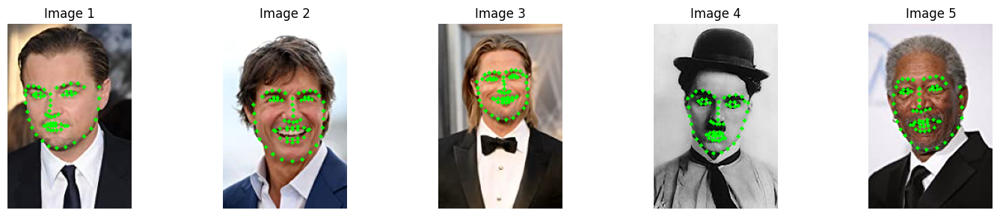

In [353]:
import os
import dlib
import cv2
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw

# Загрузить предиктор для детекции точек (68 или 5 точек, проверьте, какой у вас)
predictor_path = "/Users/muzafarov/Desktop/MyEducation/Interview/OneCell/dlib-models/shape_predictor_68_face_landmarks.dat"  # Путь к файлу с моделью
face_detector = dlib.get_frontal_face_detector()  # Детектор лиц
landmark_predictor = dlib.shape_predictor(predictor_path)  # Предиктор точек

# Директория с изображениями лиц
face_images_dir = '/Users/muzafarov/Desktop/MyEducation/Interview/OneCell/image/face_img'

# Получить список файлов изображений
image_files = sorted(os.listdir(face_images_dir))  # Получить все файлы изображений

# Подготовка для вывода первых пяти изображений через subplot
fig, axes = plt.subplots(1, 5, figsize=(15, 3))  # Уменьшенный размер рисунка

# Обработать каждое изображение
for idx, file in enumerate(image_files):
    image_path = os.path.join(face_images_dir, file)  # Полный путь к изображению
    image = cv2.imread(image_path)  # Загрузить изображение
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)  # Преобразовать в оттенки серого

    # Найти лица на изображении
    faces = face_detector(gray_image)  
    if len(faces) == 0:  # Если нет лиц
        continue  # Пропустить и перейти к следующему изображению
    
    # Нарисовать точки на каждом лице
    for face in faces:
        landmarks = landmark_predictor(gray_image, face)  # Предсказать точки
        for n in range(68):  # Если используется предиктор с 68 точками
            x = landmarks.part(n).x
            y = landmarks.part(n).y
            cv2.circle(image, (x, y), 2, (0, 255, 0), -1)  # Зеленый цвет

    # Добавить изображение к subplot (только первые 5)
    if idx < 5:  # Только для первых пяти изображений
        axes[idx].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Показать изображение
        axes[idx].set_title(f"Image {idx + 1}")  # Установить заголовок
        axes[idx].axis("off")  # Скрыть оси

plt.tight_layout()  # Улучшить внешний вид
plt.show()  # Показать весь рисунок


## 2. Оценка метрик и валидация моделей

In [354]:
import zipfile
import pandas as pd
import numpy as np

In [355]:
# Путь к директории, где находятся ваши ZIP-файлы
zip_files_dir = 'facial-keypoints-detection'

# Путь к директории, где вы хотите разархивировать файлы
extract_to_dir = 'facial-keypoints-detection'

# Разархивировать training.zip
training_zip_path = os.path.join(zip_files_dir, 'training.zip')
with zipfile.ZipFile(training_zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to_dir)
    print(f"Файл {training_zip_path} разархивирован в {extract_to_dir}")

# Разархивировать test.zip
test_zip_path = os.path.join(zip_files_dir, 'test.zip')
with zipfile.ZipFile(test_zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to_dir)
    print(f"Файл {test_zip_path} разархивирован в {extract_to_dir}")

Файл facial-keypoints-detection/training.zip разархивирован в facial-keypoints-detection
Файл facial-keypoints-detection/test.zip разархивирован в facial-keypoints-detection


In [356]:
train_data = pd.read_csv('facial-keypoints-detection/training.csv')
test_data = pd.read_csv('facial-keypoints-detection/test.zip')

In [357]:
train_data = train_data.dropna(axis=0, how='any').reset_index(drop=True)

## Приведем к норм виду столбец Image

In [358]:
for i in range(len(train_data)):
    train_data['Image'].iloc[i] = list(map(int, train_data['Image'].iloc[i].split()))
    

/var/folders/yj/nhkf3nv505d5kh0dsk42f3ym0000gn/T/ipykernel_1624/3320634999.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_data['Image'].iloc[i] = list(map(int, train_data['Image'].iloc[i].split()))
/var/folders/yj/nhkf3nv505d5kh0dsk42f3ym0000gn/T/ipykernel_1624/3320634999.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_data['Image'].iloc[i] = list(map(int, train_data['Image'].iloc[i].split()))
/var/folders/yj/nhkf3nv505d5kh0dsk42f3ym0000gn/T/ipykernel_1624/3320634999.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentatio

In [359]:
all_train_data = len(train_data)

## Pipeline

In [360]:
data = {
    "Image": [],
    "points_x": [],
    "points_y": []
}

landmarks_pred = pd.DataFrame(data)

landmarks_pred

,Image,points_x,points_y


In [361]:
image_del = 0
for i in range(len(train_data)):
    image2d = np.array(train_data['Image'][i])

    image_2d = image2d.reshape((96, 96))
    image_2d = image_2d.astype(np.uint8)

    faces = face_detector(image_2d)
    if len(faces) > 0:
        face = faces[0]  # Возьмем первое лицо
        landmarks = landmark_predictor(image_2d, face)  # Предсказать точки

        # Получить координаты всех 68 точек
        points_x = [landmarks.part(n).x for n in range(68)]
        points_y = [landmarks.part(n).y for n in range(68)]

        new_row = {
            "Image": train_data['Image'][i],  # или другое подходящее значение
            "points_x": points_x,  # Список значений x
            "points_y": points_y   # Список значений y
        }

        # Добавить новую строку в DataFrame, используя pandas.concat
        landmarks_pred = pd.concat([landmarks_pred, pd.DataFrame([new_row])], ignore_index=True)
    else:
        train_data = train_data.drop(i)
        image_del += 1

print(f'Не обнаружено {image_del} лиц(а). Эти изображения были удалены')
landmarks_pred

Не обнаружено 52 лиц(а). Эти изображения были удалены


,Image,points_x,points_y
0,"[238, 236, 237, 238, 240, 240, 239, 241, 241, ...","[10, 8, 8, 8, 10, 15, 22, 32, 43, 55, 66, 74, ...","[43, 54, 65, 75, 85, 93, 98, 100, 101, 101, 99..."
1,"[219, 215, 204, 196, 204, 211, 212, 200, 180, ...","[8, 8, 9, 12, 16, 21, 27, 34, 42, 51, 58, 65, ...","[31, 41, 52, 62, 71, 80, 88, 95, 97, 96, 92, 8..."
2,"[144, 142, 159, 180, 188, 188, 184, 180, 167, ...","[12, 13, 15, 17, 20, 24, 31, 38, 48, 58, 66, 7...","[39, 48, 57, 66, 75, 83, 90, 96, 97, 95, 90, 8..."
3,"[193, 192, 193, 194, 194, 194, 193, 192, 168, ...","[9, 11, 13, 16, 20, 26, 34, 43, 53, 62, 69, 75...","[36, 47, 58, 68, 77, 85, 91, 95, 96, 94, 89, 8..."
4,"[147, 148, 160, 196, 215, 214, 216, 217, 219, ...","[13, 12, 12, 13, 16, 20, 26, 34, 44, 55, 65, 7...","[39, 49, 60, 70, 80, 88, 94, 97, 99, 99, 97, 9..."
...,...,...,...
2083,"[191, 191, 191, 190, 189, 185, 184, 120, 54, 3...","[11, 12, 13, 15, 18, 24, 31, 38, 49, 60, 70, 7...","[32, 42, 53, 64, 74, 83, 91, 97, 99, 98, 92, 8..."
2084,"[19, 19, 19, 18, 13, 7, 3, 4, 3, 1, 3, 9, 11, ...","[-5, -4, -2, -1, 2, 9, 21, 35, 49, 62, 72, 78,...","[39, 51, 63, 75, 86, 93, 97, 100, 99, 99, 95, ..."
2085,"[31, 40, 47, 31, 54, 58, 63, 100, 86, 80, 82, ...","[-3, -3, -2, -2, 1, 7, 17, 29, 42, 55, 66, 74,...","[36, 48, 60, 73, 84, 93, 99, 103, 104, 102, 98..."
2086,"[7, 1, 5, 1, 3, 20, 12, 0, 5, 8, 6, 18, 13, 9,...","[3, 7, 12, 16, 22, 30, 40, 53, 65, 76, 83, 89,...","[47, 57, 67, 77, 86, 93, 98, 101, 99, 95, 88, ..."


In [362]:
train_data.columns

Index(['left_eye_center_x', 'left_eye_center_y', 'right_eye_center_x',
       'right_eye_center_y', 'left_eye_inner_corner_x',
       'left_eye_inner_corner_y', 'left_eye_outer_corner_x',
       'left_eye_outer_corner_y', 'right_eye_inner_corner_x',
       'right_eye_inner_corner_y', 'right_eye_outer_corner_x',
       'right_eye_outer_corner_y', 'left_eyebrow_inner_end_x',
       'left_eyebrow_inner_end_y', 'left_eyebrow_outer_end_x',
       'left_eyebrow_outer_end_y', 'right_eyebrow_inner_end_x',
       'right_eyebrow_inner_end_y', 'right_eyebrow_outer_end_x',
       'right_eyebrow_outer_end_y', 'nose_tip_x', 'nose_tip_y',
       'mouth_left_corner_x', 'mouth_left_corner_y', 'mouth_right_corner_x',
       'mouth_right_corner_y', 'mouth_center_top_lip_x',
       'mouth_center_top_lip_y', 'mouth_center_bottom_lip_x',
       'mouth_center_bottom_lip_y', 'Image'],
      dtype='object')

## Удалим ненужные столбцы

In [363]:
train_data = train_data.drop(columns=['left_eye_center_x', 'left_eye_center_y', 'right_eye_center_x', 'right_eye_center_y', 'mouth_center_top_lip_x',
       'mouth_center_top_lip_y', 'mouth_center_bottom_lip_x',
       'mouth_center_bottom_lip_y'])

In [364]:
column_names = train_data.columns.tolist()
column_names.remove('Image')
column_names

['left_eye_inner_corner_x',
 'left_eye_inner_corner_y',
 'left_eye_outer_corner_x',
 'left_eye_outer_corner_y',
 'right_eye_inner_corner_x',
 'right_eye_inner_corner_y',
 'right_eye_outer_corner_x',
 'right_eye_outer_corner_y',
 'left_eyebrow_inner_end_x',
 'left_eyebrow_inner_end_y',
 'left_eyebrow_outer_end_x',
 'left_eyebrow_outer_end_y',
 'right_eyebrow_inner_end_x',
 'right_eyebrow_inner_end_y',
 'right_eyebrow_outer_end_x',
 'right_eyebrow_outer_end_y',
 'nose_tip_x',
 'nose_tip_y',
 'mouth_left_corner_x',
 'mouth_left_corner_y',
 'mouth_right_corner_x',
 'mouth_right_corner_y']

In [365]:
# Добавить пустые столбцы в landmarks_pred
for column in column_names:
    landmarks_pred[column] = np.nan  # Или None, если хотите оставить значения по умолчанию


## Pipeline для добавления в таблицу предсказаний

In [366]:
for i in range(len(landmarks_pred)):

    landmarks_pred['nose_tip_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][33]
    landmarks_pred['nose_tip_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][33]

    landmarks_pred['left_eye_inner_corner_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][42]
    landmarks_pred['left_eye_inner_corner_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][42]

    landmarks_pred['left_eye_outer_corner_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][45]
    landmarks_pred['left_eye_outer_corner_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][45]

    landmarks_pred['right_eye_inner_corner_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][39]
    landmarks_pred['right_eye_inner_corner_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][39]

    landmarks_pred['right_eye_outer_corner_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][36]
    landmarks_pred['right_eye_outer_corner_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][36]

    landmarks_pred['left_eyebrow_inner_end_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][22]
    landmarks_pred['left_eyebrow_inner_end_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][22]

    landmarks_pred['left_eyebrow_outer_end_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][26]
    landmarks_pred['left_eyebrow_outer_end_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][26]

    landmarks_pred['right_eyebrow_inner_end_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][21]
    landmarks_pred['right_eyebrow_inner_end_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][21]

    landmarks_pred['right_eyebrow_outer_end_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][17]
    landmarks_pred['right_eyebrow_outer_end_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][17]

    landmarks_pred['right_eyebrow_outer_end_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][17]
    landmarks_pred['right_eyebrow_outer_end_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][17]

    landmarks_pred['mouth_left_corner_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][54]
    landmarks_pred['mouth_left_corner_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][54]

    landmarks_pred['mouth_right_corner_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][48]
    landmarks_pred['mouth_right_corner_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][48]

/var/folders/yj/nhkf3nv505d5kh0dsk42f3ym0000gn/T/ipykernel_1624/2392797948.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  landmarks_pred['nose_tip_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][33]
/var/folders/yj/nhkf3nv505d5kh0dsk42f3ym0000gn/T/ipykernel_1624/2392797948.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  landmarks_pred['nose_tip_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][33]
/var/folders/yj/nhkf3nv505d5kh0dsk42f3ym0000gn/T/ipykernel_1624/2392797948.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https

In [367]:
landmarks_pred = landmarks_pred.drop(columns=['points_x', 'points_y'])

In [368]:
first_column = landmarks_pred.columns[0]  # Получить название первого столбца
remaining_columns = landmarks_pred.columns[1:]  # Все, кроме первого столбца

# Создать новый порядок столбцов
new_column_order = list(remaining_columns) + [first_column]

# Переставить столбцы в нужном порядке
landmarks_pred = landmarks_pred[new_column_order]

In [369]:
landmarks_pred.shape

(2088, 23)

In [370]:
train_data.shape

(2088, 23)

In [371]:
train_data.columns.tolist()

['left_eye_inner_corner_x',
 'left_eye_inner_corner_y',
 'left_eye_outer_corner_x',
 'left_eye_outer_corner_y',
 'right_eye_inner_corner_x',
 'right_eye_inner_corner_y',
 'right_eye_outer_corner_x',
 'right_eye_outer_corner_y',
 'left_eyebrow_inner_end_x',
 'left_eyebrow_inner_end_y',
 'left_eyebrow_outer_end_x',
 'left_eyebrow_outer_end_y',
 'right_eyebrow_inner_end_x',
 'right_eyebrow_inner_end_y',
 'right_eyebrow_outer_end_x',
 'right_eyebrow_outer_end_y',
 'nose_tip_x',
 'nose_tip_y',
 'mouth_left_corner_x',
 'mouth_left_corner_y',
 'mouth_right_corner_x',
 'mouth_right_corner_y',
 'Image']

## Вычисляем метрики

Для оценки детектирования точек (то есть, получилось ли у модели обнаружить точки на изображении) я предлагаю использовать отоношение фотографий, на которых было найдено лицо к общему количеству используемых фотографий.

In [372]:
len(train_data) / all_train_data

0.9757009345794393

### Для точности позиционирования можем посчитать следующие метрики:
- MSE
- MAE
- Евклидово расстояние

С MSE и MAE будут непонятности в интерпретируемости, так как у нас есть значение по двум координатам и придется по ним усреднять значение ошибки.


А с евклидовым расстоянием как раз всё понятно. Максимальное короткое расстояние таргет-оценка.


In [373]:
import pandas as pd
import numpy as np

landmark_pairs = [
    ('left_eye_inner_corner', 'x', 'y'),
    ('left_eye_outer_corner', 'x', 'y'),
    ('right_eye_inner_corner', 'x', 'y'),
    ('right_eye_outer_corner', 'x', 'y'),
    ('left_eyebrow_inner_end', 'x', 'y'),
    ('left_eyebrow_outer_end', 'x', 'y'),
    ('right_eyebrow_inner_end', 'x', 'y'),
    ('right_eyebrow_outer_end', 'x', 'y'),
    ('nose_tip', 'x', 'y'),
    ('mouth_left_corner', 'x', 'y'),
    ('mouth_right_corner', 'x', 'y'),
]

# Функция для вычисления Евклидова расстояния между двумя точками
def euclidean_distance(x1, y1, x2, y2):
    return np.sqrt((x2 - x1) ** 2 + (y2 - y1) ** 2)

# Создаем список, в котором будут храниться результаты
distance_results = []

# Вычисляем расстояние для каждой пары координат
for name, axis_x, axis_y in landmark_pairs:
    pred_x = landmarks_pred[f"{name}_{axis_x}"]
    pred_y = landmarks_pred[f"{name}_{axis_y}"]
    true_x = train_data[f"{name}_{axis_x}"]
    true_y = train_data[f"{name}_{axis_y}"]
    
    # Вычисляем расстояния
    distance = euclidean_distance(pred_x, pred_y, true_x, true_y)
    
    # Сохраняем название landmarks и среднее Евклидово расстояние
    distance_results.append({
        "landmark": name,
        "mean_distance": distance.mean()
    })

# Создаем DataFrame из списка результатов
df_results = pd.DataFrame(distance_results)

# Добавляем общее среднее расстояние в таблицу
overall_mean_distance = np.mean([d["mean_distance"] for d in distance_results])
df_results.loc[len(df_results)] = {"landmark": "Overall Mean", "mean_distance": overall_mean_distance}

df_results


,landmark,mean_distance
0,left_eye_inner_corner,3.255287
1,left_eye_outer_corner,4.198396
2,right_eye_inner_corner,3.063944
3,right_eye_outer_corner,4.161951
4,left_eyebrow_inner_end,5.238487
5,left_eyebrow_outer_end,5.509511
6,right_eyebrow_inner_end,4.929936
7,right_eyebrow_outer_end,5.672392
8,nose_tip,8.047672
9,mouth_left_corner,6.445727


### В среднем по всем предсказанным точкам происходит отклонение на 5 пикселей

In [374]:
landmarks_pred.reset_index(drop=True, inplace=True)
train_data.reset_index(drop=True, inplace=True)


In [375]:
import numpy as np

# Убедимся, что столбец 'euclidean_distance_mean' существует, и если нет, создаем его
if 'euclidean_distance_mean' not in landmarks_pred.columns:
    # Заполняем его значениями NaN или 0, или просто создаем пустой столбец
    landmarks_pred['euclidean_distance_mean'] = np.nan  # Или landmarks_pred['euclidean_distance_mean'] = 0

# Заполняем этот столбец в цикле
for i in range(len(train_data)):
    stack = []
    for name, axis_x, axis_y in landmark_pairs:
        pred_x = landmarks_pred[f"{name}_{axis_x}"].iloc[i]
        pred_y = landmarks_pred[f"{name}_{axis_y}"].iloc[i]
        true_x = train_data[f"{name}_{axis_x}"].iloc[i]
        true_y = train_data[f"{name}_{axis_y}"].iloc[i]

        # Расчет Евклидова расстояния
        distance = euclidean_distance(pred_x, pred_y, true_x, true_y)
        stack.append(distance)
    
    # Среднее значение для всех расстояний для данного индекса
    mean_distance = np.mean(np.array(stack))
    
    # Присваиваем среднее значение столбцу 'euclidean_distance_mean'
    landmarks_pred.at[i, 'euclidean_distance_mean'] = mean_distance


In [376]:
landmarks_pred_sorted = landmarks_pred.sort_values(by='euclidean_distance_mean', ascending=True)

In [377]:
# Извлекаем индексы из landmarks_pred_sorted
sorted_indices = landmarks_pred_sorted.index

# Сортируем train_data по этим индексам
train_data_sorted = train_data.loc[sorted_indices]

### Топ 3 картинки с самым высоким качеством позиционирования точек

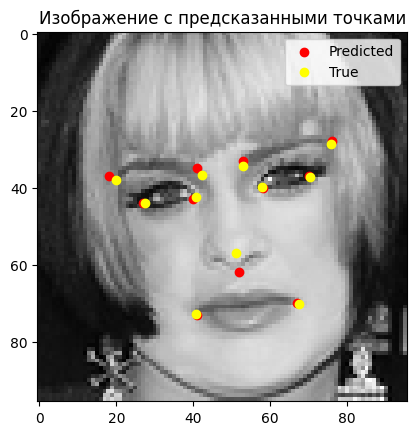

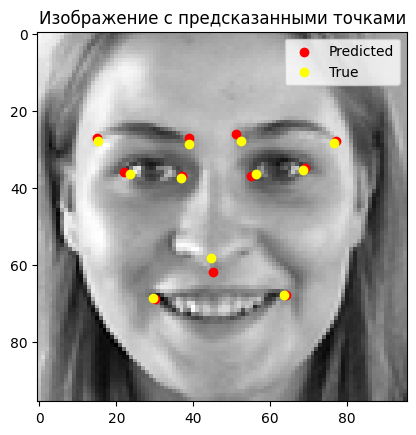

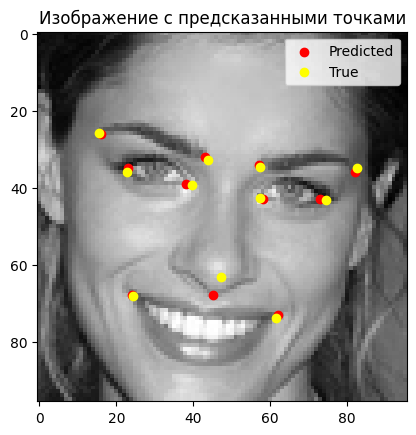

In [378]:
for i in range(3):
    image2d = np.array(landmarks_pred_sorted['Image'].iloc[i]).reshape(96, 96)

    pred_landmarks_x = [landmarks_pred_sorted[f"{name}_x"].iloc[i] for name, axis_x, axis_y in landmark_pairs]
    pred_landmarks_y = [landmarks_pred_sorted[f"{name}_y"].iloc[i] for name, axis_x, axis_y in landmark_pairs]

    true_landmarks_x = [train_data_sorted[f"{name}_x"].iloc[i] for name, axis_x, axis_y in landmark_pairs]
    true_landmarks_y = [train_data_sorted[f"{name}_y"].iloc[i] for name, axis_x, axis_y in landmark_pairs]



    # Отображаем изображение
    plt.imshow(image2d, cmap='gray')

    # Добавляем scatter plot для предсказанных точек
    plt.scatter(pred_landmarks_x, pred_landmarks_y, color='red', label='Predicted')
    plt.scatter(true_landmarks_x, true_landmarks_y, color='yellow', label='True')


    plt.title("Изображение с предсказанными точками")
    plt.legend()
    plt.show()


### Топ 3 картинки с самым низким качеством позиционирования точек

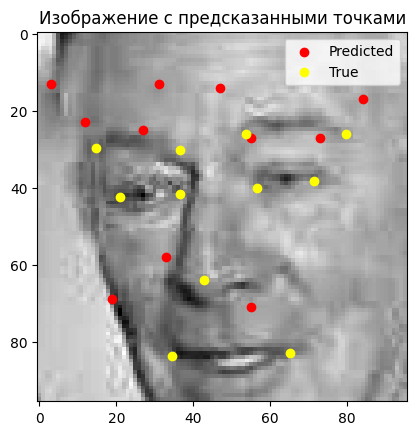

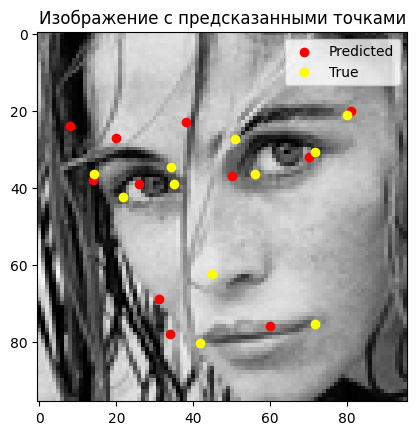

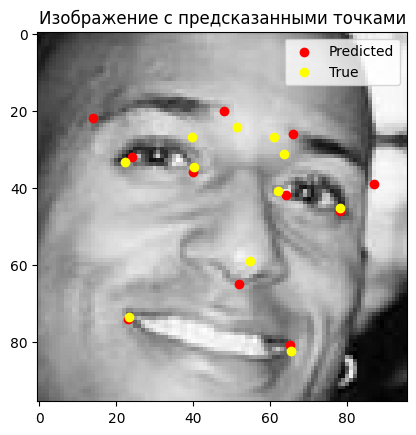

In [379]:
for i in range(-1,-4,-1):
    image2d = np.array(landmarks_pred_sorted['Image'].iloc[i]).reshape(96, 96)

    pred_landmarks_x = [landmarks_pred_sorted[f"{name}_x"].iloc[i] for name, axis_x, axis_y in landmark_pairs]
    pred_landmarks_y = [landmarks_pred_sorted[f"{name}_y"].iloc[i] for name, axis_x, axis_y in landmark_pairs]

    true_landmarks_x = [train_data_sorted[f"{name}_x"].iloc[i] for name, axis_x, axis_y in landmark_pairs]
    true_landmarks_y = [train_data_sorted[f"{name}_y"].iloc[i] for name, axis_x, axis_y in landmark_pairs]



    # Отображаем изображение
    plt.imshow(image2d, cmap='gray')

    # Добавляем scatter plot для предсказанных точек
    plt.scatter(pred_landmarks_x, pred_landmarks_y, color='red', label='Predicted')
    plt.scatter(true_landmarks_x, true_landmarks_y, color='yellow', label='True')


    plt.title("Изображение с предсказанными точками")
    plt.legend()
    plt.show()

## 3. Работа с инструментами разметки (Supervisely)

In [380]:
import supervisely as sly
import os
from supervisely.annotation.annotation import Annotation



In [381]:
import json
import supervisely as sly

api = sly.Api(server_address="https://app.supervisely.com", token="LeBqTiBkAZ9IUnTY7lnrBld293FQDOYFMpbUuxft0K2PJkrkag8LDaKHMfalnpkdTkLivcWDM8JQ6gASxkuSTiYL9XyjYu78kNzBU922mcE31i5cyBUUTlY2asn6LYrS")

my_teams = api.team.get_list()
print(f"I'm a member of {len(my_teams)} teams")

# get first team and workspace
team = my_teams[0]
workspace = api.workspace.get_list(team.id)[0]
workspace

I'm a member of 1 teams


WorkspaceInfo(id=102444, name='First Workspace', description='', team_id=88664, created_at='2024-04-22T18:04:47.567Z', updated_at='2024-04-22T18:04:47.567Z')

In [382]:
workspace_id = 102444

project_name = "My_Project"
project = api.project.create(workspace_id, project_name, change_name_if_conflict=True)

# Создание датасета
dataset_name = "My_Dataset"
dataset = api.dataset.create(project.id, dataset_name)

In [383]:
# # Полный путь к каталогу изображений
image_dir = '/Users/muzafarov/Desktop/MyEducation/Interview/OneCell/image/face_img'

# # Получаем список всех файлов в каталоге
image_files = os.listdir(image_dir)



### Необходимо получить предсказанные моделью точки на скаченных изображениях

In [384]:
data = {
    "Image": [],
    "points_x": [],
    "points_y": []
}

landmarks_pred= pd.DataFrame(data)

landmarks_pred

,Image,points_x,points_y


In [385]:
# Подготовить DataFrame для хранения результатов
landmarks_pred = pd.DataFrame()  # Инициализация DataFrame для хранения результатов

# Путь к папке с изображениями
image_folder = 'image/face_img'
image_files = os.listdir(image_folder)  # Список всех файлов в папке

# Обработать каждое изображение
for img_file in image_files:
    image_path = os.path.join(image_folder, img_file)  # Полный путь к изображению
    image = cv2.imread(image_path)  # Загрузка изображения
    
    if image is None:  # Если изображение не может быть загружено
        print(f"Не удалось загрузить изображение: {image_path}")
        continue  # Пропустить и перейти к следующему
    
    # Преобразовать в оттенки серого
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)  
    
    # Применить детектор лиц
    faces = face_detector(gray_image)  
    
    # Проверить, есть ли хотя бы одно лицо
    if len(faces) > 0:
        face = faces[0]  # Возьмем первое лицо
        landmarks = landmark_predictor(gray_image, face)  # Получить ключевые точки

        # Получить координаты всех 68 точек
        points_x = [landmarks.part(n).x for n in range(68)]
        points_y = [landmarks.part(n).y for n in range(68)]

        # Создать новую строку для DataFrame
        new_row = {
            "Image": img_file,  # Название файла изображения
            "points_x": points_x,  # Список значений x
            "points_y": points_y   # Список значений y
        }

        # Добавить новую строку в DataFrame
        landmarks_pred = pd.concat([landmarks_pred, pd.DataFrame([new_row])], ignore_index=True)

landmarks_pred

,Image,points_x,points_y
0,8.jpg,"[28, 29, 30, 31, 35, 40, 45, 52, 59, 65, 72, 7...","[69, 76, 83, 90, 96, 101, 105, 108, 107, 106, ..."
1,9.jpg,"[37, 38, 39, 41, 44, 50, 57, 65, 73, 80, 87, 9...","[61, 70, 79, 88, 96, 102, 107, 110, 111, 109, ..."
2,14.jpg,"[28, 28, 30, 32, 36, 41, 48, 55, 65, 77, 86, 9...","[80, 90, 100, 110, 119, 126, 134, 140, 142, 14..."
3,15.jpg,"[39, 42, 44, 47, 53, 62, 72, 83, 93, 101, 106,...","[80, 90, 100, 110, 117, 123, 127, 129, 128, 12..."
4,17.jpg,"[27, 28, 30, 32, 35, 42, 50, 59, 68, 78, 86, 9...","[83, 93, 103, 113, 122, 130, 136, 141, 142, 14..."
5,16.jpg,"[29, 30, 31, 32, 36, 43, 51, 60, 70, 79, 87, 9...","[76, 87, 97, 108, 117, 125, 132, 136, 138, 136..."
6,12.jpg,"[43, 44, 45, 46, 48, 53, 60, 67, 76, 84, 90, 9...","[65, 72, 78, 86, 92, 98, 103, 107, 108, 106, 1..."
7,13.jpg,"[38, 39, 40, 42, 44, 48, 53, 59, 67, 76, 83, 9...","[84, 94, 104, 113, 122, 130, 137, 144, 146, 14..."
8,11.jpg,"[34, 35, 36, 38, 41, 48, 56, 66, 78, 89, 98, 1...","[91, 101, 111, 121, 130, 139, 147, 153, 155, 1..."
9,10.jpg,"[20, 20, 22, 24, 27, 32, 39, 46, 55, 65, 75, 8...","[80, 89, 99, 108, 117, 125, 132, 138, 140, 139..."


In [386]:
# Добавить пустые столбцы в landmarks_pred
for column in column_names:
    landmarks_pred[column] = np.nan  # Или None, если хотите оставить значения по умолчанию


In [387]:
for i in range(len(landmarks_pred)):

    landmarks_pred['nose_tip_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][33]
    landmarks_pred['nose_tip_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][33]

    landmarks_pred['left_eye_inner_corner_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][42]
    landmarks_pred['left_eye_inner_corner_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][42]

    landmarks_pred['left_eye_outer_corner_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][45]
    landmarks_pred['left_eye_outer_corner_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][45]

    landmarks_pred['right_eye_inner_corner_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][39]
    landmarks_pred['right_eye_inner_corner_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][39]

    landmarks_pred['right_eye_outer_corner_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][36]
    landmarks_pred['right_eye_outer_corner_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][36]

    landmarks_pred['left_eyebrow_inner_end_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][22]
    landmarks_pred['left_eyebrow_inner_end_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][22]

    landmarks_pred['left_eyebrow_outer_end_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][26]
    landmarks_pred['left_eyebrow_outer_end_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][26]

    landmarks_pred['right_eyebrow_inner_end_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][21]
    landmarks_pred['right_eyebrow_inner_end_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][21]

    landmarks_pred['right_eyebrow_outer_end_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][17]
    landmarks_pred['right_eyebrow_outer_end_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][17]

    landmarks_pred['right_eyebrow_outer_end_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][17]
    landmarks_pred['right_eyebrow_outer_end_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][17]

    landmarks_pred['mouth_left_corner_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][54]
    landmarks_pred['mouth_left_corner_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][54]

    landmarks_pred['mouth_right_corner_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][48]
    landmarks_pred['mouth_right_corner_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][48]

/var/folders/yj/nhkf3nv505d5kh0dsk42f3ym0000gn/T/ipykernel_1624/2392797948.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  landmarks_pred['nose_tip_x'].iloc[i] = landmarks_pred['points_x'].iloc[i][33]
/var/folders/yj/nhkf3nv505d5kh0dsk42f3ym0000gn/T/ipykernel_1624/2392797948.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  landmarks_pred['nose_tip_y'].iloc[i] = landmarks_pred['points_y'].iloc[i][33]
/var/folders/yj/nhkf3nv505d5kh0dsk42f3ym0000gn/T/ipykernel_1624/2392797948.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https

In [388]:
landmarks_pred = landmarks_pred.drop(columns=['points_x', 'points_y'])
landmarks_pred

,Image,left_eye_inner_corner_x,left_eye_inner_corner_y,left_eye_outer_corner_x,left_eye_outer_corner_y,right_eye_inner_corner_x,right_eye_inner_corner_y,right_eye_outer_corner_x,right_eye_outer_corner_y,left_eyebrow_inner_end_x,...,right_eyebrow_inner_end_x,right_eyebrow_inner_end_y,right_eyebrow_outer_end_x,right_eyebrow_outer_end_y,nose_tip_x,nose_tip_y,mouth_left_corner_x,mouth_left_corner_y,mouth_right_corner_x,mouth_right_corner_y
0,8.jpg,58.0,67.0,68.0,66.0,46.0,68.0,36.0,69.0,53.0,...,48.0,61.0,31.0,66.0,53.0,84.0,65.0,90.0,47.0,93.0
1,9.jpg,82.0,60.0,92.0,60.0,65.0,60.0,55.0,60.0,76.0,...,73.0,55.0,47.0,57.0,75.0,77.0,85.0,89.0,61.0,88.0
2,14.jpg,69.0,74.0,81.0,73.0,48.0,76.0,36.0,77.0,62.0,...,50.0,63.0,31.0,71.0,59.0,99.0,80.0,110.0,47.0,114.0
3,15.jpg,93.0,72.0,104.0,71.0,75.0,74.0,63.0,76.0,90.0,...,81.0,66.0,55.0,72.0,91.0,94.0,101.0,101.0,72.0,105.0
4,17.jpg,77.0,83.0,90.0,82.0,57.0,83.0,43.0,82.0,73.0,...,60.0,75.0,34.0,77.0,68.0,104.0,82.0,115.0,53.0,116.0
5,16.jpg,82.0,79.0,93.0,80.0,60.0,79.0,49.0,78.0,79.0,...,67.0,71.0,40.0,75.0,73.0,104.0,85.0,111.0,55.0,109.0
6,12.jpg,80.0,60.0,89.0,60.0,65.0,62.0,55.0,63.0,76.0,...,68.0,55.0,49.0,62.0,74.0,78.0,88.0,82.0,61.0,84.0
7,13.jpg,82.0,91.0,95.0,92.0,63.0,89.0,50.0,87.0,79.0,...,68.0,82.0,43.0,81.0,71.0,113.0,80.0,129.0,59.0,125.0
8,11.jpg,88.0,86.0,100.0,85.0,66.0,86.0,53.0,86.0,85.0,...,70.0,78.0,44.0,82.0,79.0,111.0,97.0,119.0,57.0,120.0
9,10.jpg,62.0,80.0,76.0,78.0,41.0,81.0,29.0,80.0,55.0,...,41.0,74.0,20.0,75.0,49.0,105.0,67.0,115.0,41.0,115.0


## Начинается загрузка картинок с разметкой на supervisely

In [389]:
import supervisely as sly
from supervisely.geometry.graph import Node, KeypointsTemplate
import os
import json
from dotenv import load_dotenv

# Основной Pipeline

In [390]:
for i in range(len(image_files)):
    template = KeypointsTemplate()
    # Добавление точек в шаблон на основе данных из landmarks_pred
    template.add_point(
        label="left_eye_inner_corner",
        row=landmarks_pred["left_eye_inner_corner_x"].iloc[i],
        col=landmarks_pred["left_eye_inner_corner_y"].iloc[i],
    )

    template.add_point(
        label="left_eye_outer_corner",
        row=landmarks_pred["left_eye_outer_corner_x"].iloc[i],
        col=landmarks_pred["left_eye_outer_corner_y"].iloc[i],
    )

    template.add_point(
        label="right_eye_inner_corner",
        row=landmarks_pred["right_eye_inner_corner_x"].iloc[i],
        col=landmarks_pred["right_eye_inner_corner_y"].iloc[i],
    )

    template.add_point(
        label="right_eye_outer_corner",
        row=landmarks_pred["right_eye_outer_corner_x"].iloc[i],
        col=landmarks_pred["right_eye_outer_corner_y"].iloc[i],
    )

    template.add_point(
        label="left_eyebrow_inner_end",
        row=landmarks_pred["left_eyebrow_inner_end_x"].iloc[i],
        col=landmarks_pred["left_eyebrow_inner_end_y"].iloc[i],
    )

    template.add_point(
        label="left_eyebrow_outer_end",
        row=landmarks_pred["left_eyebrow_outer_end_x"].iloc[i],
        col=landmarks_pred["left_eyebrow_outer_end_y"].iloc[i],
    )

    template.add_point(
        label="right_eyebrow_outer_end",
        row=landmarks_pred["right_eyebrow_outer_end_x"].iloc[i],
        col=landmarks_pred["right_eyebrow_outer_end_y"].iloc[i],
    )

    template.add_point(
        label="nose_tip",
        row=landmarks_pred["nose_tip_x"].iloc[i],
        col=landmarks_pred["nose_tip_y"].iloc[i],
    )

    template.add_point(
        label="mouth_left_corner",
        row=landmarks_pred["mouth_left_corner_x"].iloc[i],
        col=landmarks_pred["mouth_left_corner_y"].iloc[i],
    )

    template.add_point(
        label="mouth_right_corner",
        row=landmarks_pred["mouth_right_corner_x"].iloc[i],
        col=landmarks_pred["mouth_right_corner_y"].iloc[i],
    )

    template_img = sly.image.read(f"image/face_img/{image_files[i]}")
    template.draw(image=template_img, thickness=7)
    sly.image.write(f"images/template{i}.jpg", template_img)

    landmark = sly.ObjClass("person", geometry_type=sly.GraphNodes, geometry_config=template)
    project_meta = sly.ProjectMeta(obj_classes=[landmark])
    api.project.update_meta(project.id, project_meta.to_json())

    image_info = api.image.upload_path(
        dataset.id, name=f"{image_files[i]}", path=f"image/face_img/{image_files[i]}")

    nodes = [
        sly.Node(label="left_eye_inner_corner", row=landmarks_pred['left_eye_inner_corner_y'].iloc[i], col=landmarks_pred['left_eye_inner_corner_x'].iloc[i]),
        sly.Node(label="left_eye_outer_corner", row=landmarks_pred['left_eye_outer_corner_y'].iloc[i], col=landmarks_pred['left_eye_outer_corner_x'].iloc[i]),
        sly.Node(label="right_eye_inner_corner", row=landmarks_pred['right_eye_inner_corner_y'].iloc[i], col=landmarks_pred['right_eye_inner_corner_x'].iloc[i]),
        sly.Node(label="right_eye_outer_corner", row=landmarks_pred['right_eye_outer_corner_y'].iloc[i], col=landmarks_pred['right_eye_outer_corner_x'].iloc[i]),
        sly.Node(label="left_eyebrow_inner_end", row=landmarks_pred['left_eyebrow_inner_end_y'].iloc[i], col=landmarks_pred['left_eyebrow_inner_end_x'].iloc[i]),
        sly.Node(label="left_eyebrow_outer_end", row=landmarks_pred['left_eyebrow_outer_end_y'].iloc[i], col=landmarks_pred['left_eyebrow_outer_end_x'].iloc[i]),
        sly.Node(label="right_eyebrow_outer_end", row=landmarks_pred['right_eyebrow_outer_end_y'].iloc[i], col=landmarks_pred['right_eyebrow_outer_end_x'].iloc[i]),
        sly.Node(label="nose_tip", row=landmarks_pred['nose_tip_y'].iloc[i], col=landmarks_pred['nose_tip_x'].iloc[i]),
        sly.Node(label="mouth_left_corner", row=landmarks_pred['mouth_left_corner_y'].iloc[i], col=landmarks_pred['mouth_left_corner_x'].iloc[i]),
        sly.Node(label="mouth_right_corner", row=landmarks_pred['mouth_right_corner_y'].iloc[i], col=landmarks_pred['mouth_right_corner_x'].iloc[i]),
    ]

    input_image = sly.image.read(f"image/face_img/{image_files[i]}")
    img_height, img_width = input_image.shape[:2]
    label = sly.Label(sly.GraphNodes(nodes), landmark)
    ann = sly.Annotation(img_size=[img_height, img_width], labels=[label])
    api.annotation.upload_ann(image_info.id, ann)

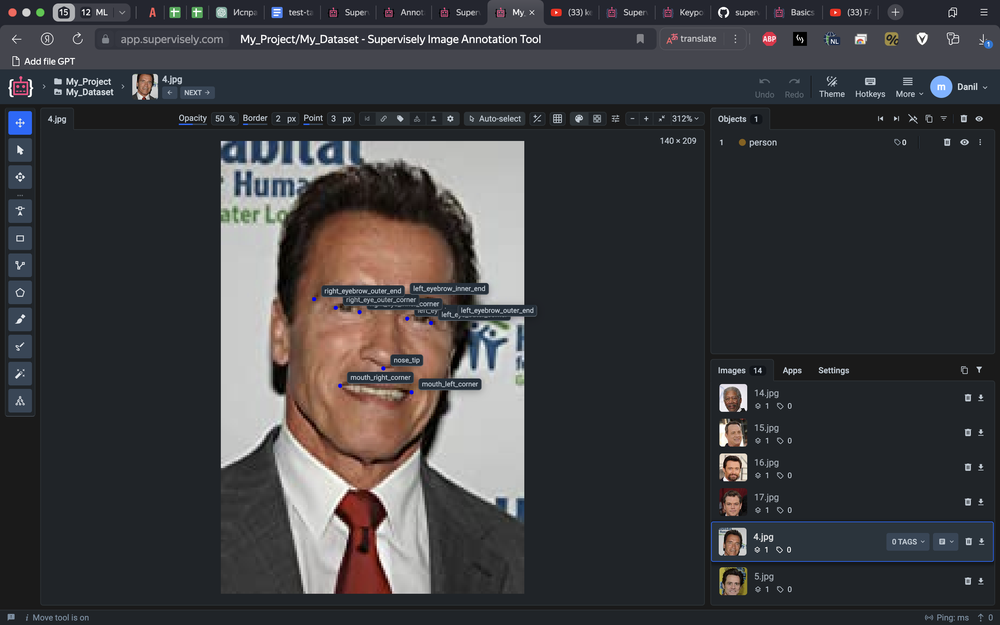

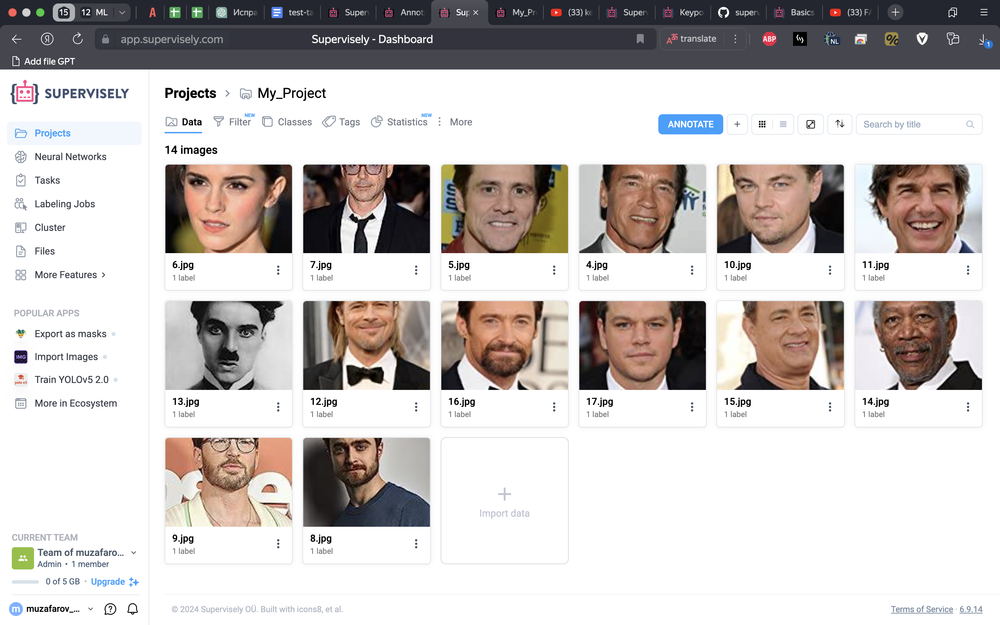

## По времени разметки

Если размечать вручную, то на разметку одного лица и 11 точек уходит около минуты.

Можно предствить сколько уйдет на 68 точек...

Модель это делает практически моментально и в основном достаточно точно. Выгрузка фотографии с предсказанной разметкой занимает у меня около 1,5 сек. Дальше, если это необходимо, можно дать разметчикам-аннотаторам вручную просмотреть разметку картинок, сделанные моделью и в случае чего подправить разметку.